In [2]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 

data = pd.read_csv('headbrain.csv')

data.head()

,Gender,Age Range,Head Size(cm^3),Brain Weight(grams)
0,1,1,4512,1530
1,1,1,3738,1297
2,1,1,4261,1335
3,1,1,3777,1282
4,1,1,4177,1590


Mean Squared Error: 3148.956702415179


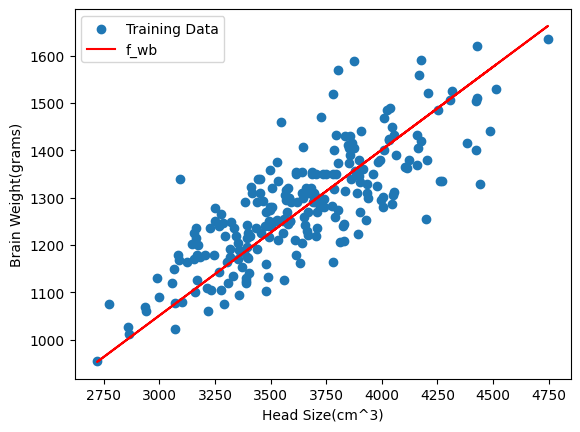

In [45]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'data' is already loaded
x_train = data['Head Size(cm^3)'].values
y_train = data['Brain Weight(grams)'].values
m = len(x_train)

w = 0.3502782
b = 0.24654654

# Create y_values_predicted based on x_train
y_values_predicted = [w*x + b for x in x_train]

def compute_cost(y_actual, y_predicted):
    # Ensure that the lengths of y_actual and y_predicted are the same
    assert len(y_actual) == len(y_predicted), "Lengths of y_actual and y_predicted must be the same"
    
    squared_errors = [(y_predicted[i] - y_actual[i]) ** 2 for i in range(len(y_actual))]
    mean_squared_error = (1 / (2 * m)) * sum(squared_errors)
    return mean_squared_error

# Calculate the cost
cost = compute_cost(y_train, y_values_predicted)
print(f"Mean Squared Error: {cost}")

# Plotting
plt.scatter(x_train, y_train, label='Training Data')
plt.plot(x_train, y_values_predicted, color='red', label='f_wb')
plt.xlabel('Head Size(cm^3)')
plt.ylabel('Brain Weight(grams)')
plt.legend()
plt.show()


### now we have to reduce mean squared error but we dont know the perfect values for w and b which will reduce the mean squared error 

SO we will be using gradient descent for finding the perfect w and b

In [65]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'data' is already loaded
x_train = data['Head Size(cm^3)'].values
y_train = data['Brain Weight(grams)'].values
m = len(x_train)

# Feature Scaling
x_mean = np.mean(x_train)
x_std = np.std(x_train)
x_train = (x_train - x_mean) / x_std

# Initialize parameters
w = 0.3  # Initial value for w
b = 0.2  # Initial value for b
alpha = 0.0001  # Reduced learning rate
iterations = 1000000  # Number of iterations

# Gradient Descent
for i in range(iterations):
    # Compute predictions
    y_predicted = [w*x + b for x in x_train]
    
    # Compute gradients
    dw = (1/m) * sum([(y_predicted[j] - y_train[j]) * x_train[j] for j in range(m)])
    db = (1/m) * sum([(y_predicted[j] - y_train[j]) for j in range(m)])
    
    # Update parameters
    w = w - alpha * dw
    b = b - alpha * db
    
    # Compute the cost
    cost = compute_cost(y_train, y_predicted)
    print(f"Iteration {i+1}, Mean Squared Error: {cost}")

# Create y_values_predicted based on updated parameters
y_values_predicted = [w*x + b for x in x_train]

# Plotting
plt.scatter(x_train, y_train, label='Training Data')
plt.plot(x_train, y_values_predicted, color='red', label='f_wb (Final)')
plt.xlabel('Head Size(cm^3)')
plt.ylabel('Brain Weight(grams)')
plt.legend()
plt.show()


Iteration 1, Mean Squared Error: 829807.1471326711
Iteration 2, Mean Squared Error: 829641.7141137116
Iteration 3, Mean Squared Error: 829476.3141797022
Iteration 4, Mean Squared Error: 829310.947324025
Iteration 5, Mean Squared Error: 829145.6135400662
Iteration 6, Mean Squared Error: 828980.3128212101
Iteration 7, Mean Squared Error: 828815.0451608445
Iteration 8, Mean Squared Error: 828649.8105523586
Iteration 9, Mean Squared Error: 828484.6089891425
Iteration 10, Mean Squared Error: 828319.4404645859
Iteration 11, Mean Squared Error: 828154.3049720839
Iteration 12, Mean Squared Error: 827989.2025050282
Iteration 13, Mean Squared Error: 827824.1330568151
Iteration 14, Mean Squared Error: 827659.0966208403
Iteration 15, Mean Squared Error: 827494.093190504
Iteration 16, Mean Squared Error: 827329.1227592031
Iteration 17, Mean Squared Error: 827164.1853203385
Iteration 18, Mean Squared Error: 826999.2808673112
Iteration 19, Mean Squared Error: 826834.4093935266
Iteration 20, Mean Squa

KeyboardInterrupt: 

as the MSE is not reducing we will be doing an 
Adjust Learning Rate: Experiment with different values for the learning rate 
α to find an optimal value that helps the algorithm converge faster without overshooting
Check Convergence Criteria: You can add a convergence criteria to stop the gradient descent algorithm once the change in the cost function or parameters falls below a certain threshold.
Regularization: Consider adding regularization to the cost function to prevent overfitting and improve generalization.

Feature Engineering: Consider adding polynomial features or interaction terms to the input features to capture more complex relationships between the variables.

Normalization of Target Variable: If the target variable (Brain Weight) has a wide range of values, you can normalize it to a smaller range, such as [0, 1], which can help stabilize the training process.

Iteration 1: w = 0.15034312915092543, b = 0.246521885346, dw = -0.6492915092542964, db = 0.2465465400000001
Iteration 1, Mean Squared Error: 0.42152647020934675
Iteration 2: w = 0.15040805180893577, b = 0.2464972331574654, dw = -0.6492265801033705, db = 0.24652188534600014
Iteration 2, Mean Squared Error: 0.42147823615513247
Iteration 3: w = 0.1504729679746803, b = 0.24647258343414966, dw = -0.6491616574453604, db = 0.2464972331574655
Iteration 3, Mean Squared Error: 0.4214300117472465
Iteration 4: w = 0.15053787764880824, b = 0.24644793617580624, dw = -0.649096741279616, db = 0.2464725834341497
Iteration 4, Mean Squared Error: 0.4213817969837601
Iteration 5: w = 0.1506027808319688, b = 0.24642329138218866, dw = -0.6490318316054884, db = 0.2464479361758063
Iteration 5, Mean Squared Error: 0.4213335918627443
Iteration 6: w = 0.15066767752481103, b = 0.24639864905305045, dw = -0.6489669284223278, db = 0.2464232913821887
Iteration 6, Mean Squared Error: 0.4212853963822709
Iteration 7: w =

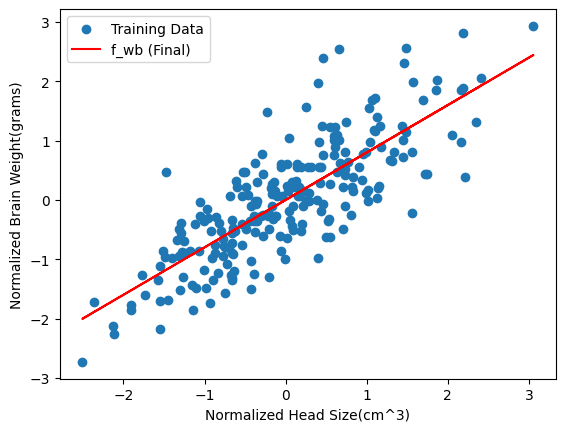

In [85]:
x_train = data['Head Size(cm^3)'].values
y_train = data['Brain Weight(grams)'].values
m = len(x_train)

# Feature Scaling
x_mean = np.mean(x_train)
x_std = np.std(x_train)
x_train = (x_train - x_mean) / x_std

# Normalize the target variable
y_mean = np.mean(y_train)
y_std = np.std(y_train)
y_train = (y_train - y_mean) / y_std

# Initialize parameters
w = 0.1502782
b = 0.24654654  # Initial value for b
alpha = 0.0001  # Reduced learning rate
iterations = 100000  # Number of iterations
epsilon = 1e-11  # Convergence criteria

prev_cost = float('inf')

# Gradient Descent
for i in range(iterations):
    # Compute predictions
    y_predicted = [w*x + b for x in x_train]
    
    # Compute gradients
    dw = (1/m) * sum([(y_predicted[j] - y_train[j]) * x_train[j] for j in range(m)])
    db = (1/m) * sum([(y_predicted[j] - y_train[j]) for j in range(m)])
    
    # Update parameters
    w = w - alpha * dw
    b = b - alpha * db
    
    # Debugging: Print the updated parameters and gradients
    print(f"Iteration {i+1}: w = {w}, b = {b}, dw = {dw}, db = {db}")
    
    # Compute the cost
    cost = compute_cost(y_train, y_predicted)
    print(f"Iteration {i+1}, Mean Squared Error: {cost}")
    
    # Check for convergence
    if abs(cost - prev_cost) < epsilon:
        print("Converged!")
        break
    
    prev_cost = cost


# Create y_values_predicted based on updated parameters
y_values_predicted = [(w*x + b) for x in x_train]

# Plotting the data and the fitted line
plt.scatter(x_train, y_train, label='Training Data')
plt.plot(x_train, [w*x + b for x in x_train], color='red', label='f_wb (Final)')
plt.xlabel('Normalized Head Size(cm^3)')
plt.ylabel('Normalized Brain Weight(grams)')
plt.legend()
plt.show()



In [68]:
df = pd.read_csv('headbrain.csv')
df

,Gender,Age Range,Head Size(cm^3),Brain Weight(grams)
0,1,1,4512,1530
1,1,1,3738,1297
2,1,1,4261,1335
3,1,1,3777,1282
4,1,1,4177,1590
...,...,...,...,...
232,2,2,3214,1110
233,2,2,3394,1215
234,2,2,3233,1104
235,2,2,3352,1170
